$$- \Delta u(x) = f(x) \hspace{0.2cm} \text{on} \hspace{0.2cm} D(\omega_2)$$

In [1]:
import matplotlib.pyplot as plt
import fenics as fe
import mshr
import numpy as np
import plotly.graph_objects as go
from scipy.interpolate import griddata

from helpers import *

In [2]:
MESH_RESOLUTION_RANDOM_FIELD_CALCULATION = 4


# Define covariance functions
def v_cov1_1 (x, y):
    return 5.0/100.0 * np.exp(-4.0 * ((x[0] - y[0])**2 + (x[1] - y[1])**2))
def v_cov1_2 (x, y):
    return 1.0/100.0 * np.exp(-0.1 * ((2*x[0] - y[0])**2 + (2*x[1] - y[1])**2))
def v_cov2_1 (x, y):
    return 1.0/100.0 * np.exp(-0.1 * ((x[0] - 2*y[0])**2 + (x[1] - 2*y[1])**2))
def v_cov2_2 (x, y):
    return 5.0/100.0 * np.exp(-1.0 * ((x[0] - y[0])**2 + (x[1] - y[1])**2))


In [11]:
# Understand differentiable basis functions
mesh = mshr.generate_mesh(DOMAIN, 2)
V = fe.FunctionSpace(mesh, "BDFM", 2)
#! V = fe.FunctionSpace(mesh, "HER", 3) not supported
basis_function = fe.Function(V)
basis_function.vector()[2] = 1

def plot_basis_function(f):
    x_coords = mesh.coordinates()[:, 0]
    y_coords = mesh.coordinates()[:, 1]
    z_values = []
    for i in range(len(x_coords)):
        z_values.append(f(x_coords[i], y_coords[i]))
    grid_x, grid_y = np.mgrid[-1:1:500j, -1:1:500j]  # Increased resolution
    grid_z = griddata((x_coords, y_coords), z_values, (grid_x, grid_y), method='linear')
    fig = go.Figure(data=[go.Surface(z=grid_z, x=grid_x, y=grid_y, colorscale='Viridis')])
    fig.update_layout(title='Basis Function', autosize=True,
                    scene=dict(xaxis_title='x', yaxis_title='y', zaxis_title='u(x, y)'),
                    margin=dict(l=65, r=50, b=65, t=90))
    fig.show()

plot_basis_function(basis_function)

In [4]:
randomFieldV, jacobianV = calculate_vector_field_eigenpairs(MESH_RESOLUTION_RANDOM_FIELD_CALCULATION, v_cov1_1, v_cov1_2, v_cov2_1, v_cov2_2)
# for MESH_RESOLUTION_RANDOM_FIELD_CALCULATION = 3 it takes approximately: 6 minutes
# for MESH_RESOLUTION_RANDOM_FIELD_CALCULATION = 4 it takes approximately: 22 minutes

In [5]:
# for basis_function in randomFieldV.basis_functions:
#     plot_basis_function(basis_function.function)

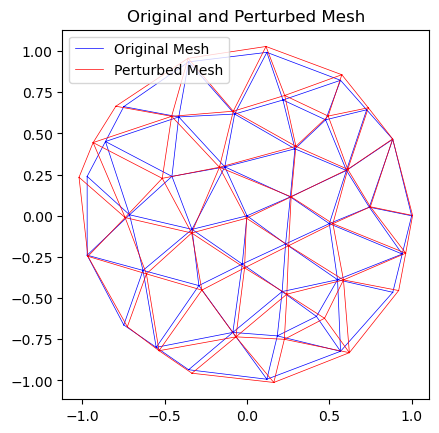

In [6]:
xi = np.random.uniform(-np.sqrt(3), np.sqrt(3), randomFieldV.J)
mesh = mshr.generate_mesh(DOMAIN, MESH_RESOLUTION_RANDOM_FIELD_CALCULATION)
# perturbed mesh based on the "original" mesh used for the KL-expansion
perturbed_coordinates = mesh.coordinates().copy()
for index, coordinate in enumerate(mesh.coordinates()):
    perturbed_coordinates[index] = randomFieldV(coordinate, xi)
# Create a new mesh with the perturbed coordinates
perturbed_mesh = fe.Mesh(mesh)
perturbed_mesh.coordinates()[:] = perturbed_coordinates

# Plot the original mesh and the perturbed mesh in one figure with different colors
plt.figure()
fe.plot(mesh, color='blue', linewidth=0.5, label='Original Mesh')
fe.plot(perturbed_mesh, color='red', linewidth=0.5, label='Perturbed Mesh')
plt.legend()
plt.title(f"Original and Perturbed Mesh")
plt.show()

randomFieldV.J: 40
Solving linear variational problem.
  Building point search tree to accelerate distance queries.
  Computed bounding box tree with 121 nodes for 61 points.


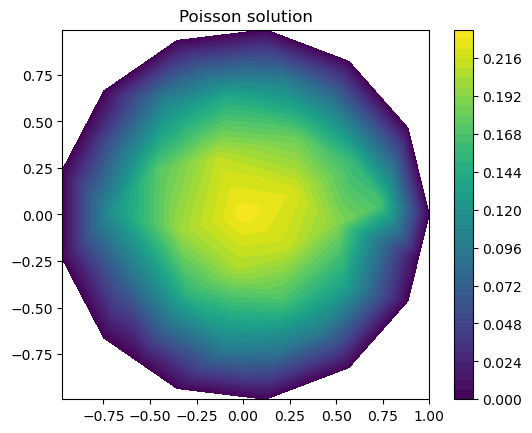

In [7]:
print(f"randomFieldV.J: {randomFieldV.J}")
xi = np.random.uniform(-np.sqrt(3), np.sqrt(3), 20)
# Ensure that len(xi) < randomFieldV.J

mesh_resolution_solution = 4
u_sol = solve_poisson_for_given_sample(mesh_resolution_solution, jacobianV, xi, RHS_F)
# len(xi) = 20 and mesh_resolution_solution = 4 lead to 1 minute 13 seconds

c = fe.plot(u_sol, title="Poisson solution")
plt.colorbar(c)
plt.show()

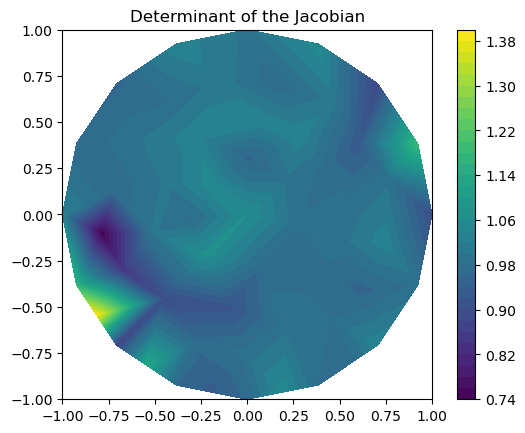

In [8]:
det_J_expr = detJExpression(jacobianV, xi, degree=2)
mesh = mshr.generate_mesh(DOMAIN, 5)
V = fe.FunctionSpace(mesh, "P", 1)
det_J_func = fe.project(det_J_expr, V)

c = fe.plot(det_J_func, title="Determinant of the Jacobian")
plt.colorbar(c)
plt.show()

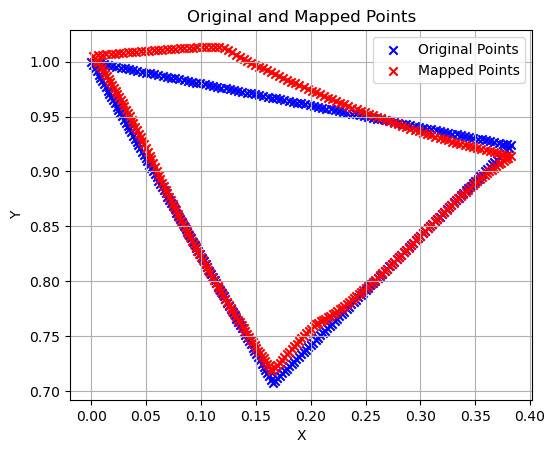

In [ ]:
xi = np.random.uniform(-np.sqrt(3), np.sqrt(3), randomFieldV.J)

number_of_points_per_edge = 100

orig_tri = next(fe.cells(mesh))
orig_tri_coords = np.array(orig_tri.get_vertex_coordinates()).reshape((-1, 2))
orig_points = []
for i in range(number_of_points_per_edge):
    orig_points.append(i/number_of_points_per_edge * orig_tri_coords[0] + (1 - i/number_of_points_per_edge) * orig_tri_coords[1])
    orig_points.append(i/number_of_points_per_edge * orig_tri_coords[1] + (1 - i/number_of_points_per_edge) * orig_tri_coords[2])
    orig_points.append(i/number_of_points_per_edge * orig_tri_coords[2] + (1 - i/number_of_points_per_edge) * orig_tri_coords[0])

mapped_points = []
for orig_point in orig_points:
    mapped_points.append(randomFieldV(orig_point, xi))


orig_points = np.array(orig_points)
mapped_points = np.array(mapped_points)

plt.figure()

# Plot original triangle points
plt.scatter(orig_points[:, 0], orig_points[:, 1], color='blue', label='Original Points', marker='x')

# Plot mapped triangle points
plt.scatter(mapped_points[:, 0], mapped_points[:, 1], color='red', label='Mapped Points', marker='x')

plt.legend()
plt.title('Original and Mapped Points')
plt.xlabel('X')
plt.ylabel('Y')
plt.grid(True)
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

image_bary_coords: [0.74558786 0.17858568 0.07582646]
image_tria_coords: [[ 0.0450942  -0.02046334]
 [-0.07459883  0.13559612]
 [-0.13582861  0.01373783]]
original_tria_coords: [[ 0.00000000e+00 -5.55111512e-17]
 [-7.16591683e-02  1.33337268e-01]
 [-1.33187893e-01  1.43455618e-02]]
New inner point in the original triangle: [-0.02289647  0.0248999 ]


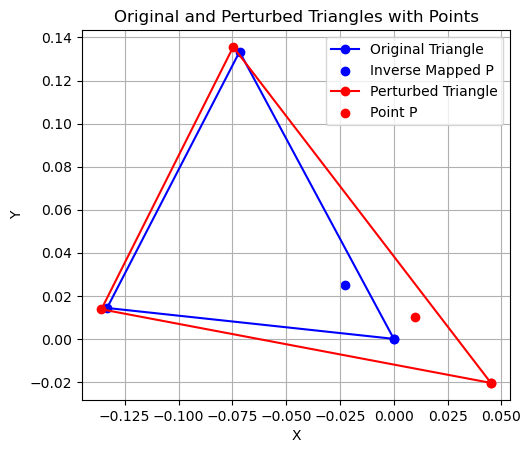

Solving linear variational problem.
inverse_mapped_P_solution: 0.24883235901621165


In [10]:
P = fe.Point(0.01, 0.01)

mesh_resolution_inverse_mapping = 8
xi = np.random.uniform(-np.sqrt(3), np.sqrt(3), randomFieldV.J)

mesh = mshr.generate_mesh(DOMAIN, mesh_resolution_inverse_mapping)
# perturbed mesh based on the "original" mesh used for the KL-expansion
perturbed_coordinates = mesh.coordinates().copy()
for index, coordinate in enumerate(mesh.coordinates()):
    perturbed_coordinates[index] = randomFieldV(coordinate, xi)
# Create a new mesh with the perturbed coordinates
perturbed_mesh = fe.Mesh(mesh)
perturbed_mesh.coordinates()[:] = perturbed_coordinates

# Find the cell containing point P
image_tria_coords = None
for cell in fe.cells(perturbed_mesh):
    if cell.contains(P):
        image_tria_coords = np.array(cell.get_vertex_coordinates()).reshape((-1, 2))
        break

if image_tria_coords is None:
    raise ValueError("Point P is not inside any cell of the perturbed mesh")
        
image_bary_coords = barycentric_coords(P, image_tria_coords)

print(f"image_bary_coords: {image_bary_coords}")

perturbed_coords = perturbed_mesh.coordinates()
original_coords = mesh.coordinates()

indices = []
for vertex in image_tria_coords:
    for i, coord in enumerate(perturbed_coords):
        if np.allclose(vertex, coord):
            indices.append(i)
            break

# Get the corresponding coordinates in the original mesh
original_tria_coords = original_coords[indices]
print(f"image_tria_coords: {image_tria_coords}")
print(f"original_tria_coords: {original_tria_coords}")

P_hat = (
    image_bary_coords[0] * original_tria_coords[0] +
    image_bary_coords[1] * original_tria_coords[1] +
    image_bary_coords[2] * original_tria_coords[2]
)
print(f"New inner point in the original triangle: {P_hat}")

# Plot the original triangle and the new_inner_point
plt.figure()

# Plot original triangle
plt.plot(*zip(*original_tria_coords, original_tria_coords[0]), 'bo-', label='Original Triangle')
plt.scatter(*P_hat, color='blue', label='Inverse Mapped P')

# Plot perturbed triangle
plt.plot(*zip(*image_tria_coords, image_tria_coords[0]), 'ro-', label='Perturbed Triangle')
plt.scatter(P.x(), P.y(), color='red', label='Point P')

plt.legend()
plt.title('Original and Perturbed Triangles with Points')
plt.xlabel('X')
plt.ylabel('Y')
plt.grid(True)
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

# Calculate the solution at the inverse mapped point
mesh_resolution_solution = 4
u_sol = solve_poisson_for_given_sample(mesh_resolution_solution, jacobianV, xi, RHS_F)
inverse_mapped_P_solution = u_sol(P_hat)
print(f"inverse_mapped_P_solution: {inverse_mapped_P_solution}")

# currently whole cell (which is one monte carlo iteration) takes 2:30 minutes

Iteration 1/2
Solving linear variational problem.
Iteration 2/2
Solving linear variational problem.
Iteration 1/4
Solving linear variational problem.
Iteration 2/4
Solving linear variational problem.
Iteration 3/4
Solving linear variational problem.
Iteration 4/4
Solving linear variational problem.
Iteration 1/8
Solving linear variational problem.
Iteration 2/8
Solving linear variational problem.
Iteration 3/8
Solving linear variational problem.
Iteration 4/8
Solving linear variational problem.
Iteration 5/8
Solving linear variational problem.
Iteration 6/8
Solving linear variational problem.
Iteration 7/8
Solving linear variational problem.
Iteration 8/8
Solving linear variational problem.
Iteration 1/16
Solving linear variational problem.
Iteration 2/16
Solving linear variational problem.
Iteration 3/16
Solving linear variational problem.
Iteration 4/16
Solving linear variational problem.
Iteration 5/16
Solving linear variational problem.
Iteration 6/16
Solving linear variational pro

/var/folders/0n/bb4_kwsn3n5c5_7n_mgl2n540000gn/T/ipykernel_56287/2958760954.py:27: UserWarning:

marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.

/var/folders/0n/bb4_kwsn3n5c5_7n_mgl2n540000gn/T/ipykernel_56287/2958760954.py:36: UserWarning:

marker is redundantly defined by the 'marker' keyword argument and the fmt string "go" (-> marker='o'). The keyword argument will take precedence.



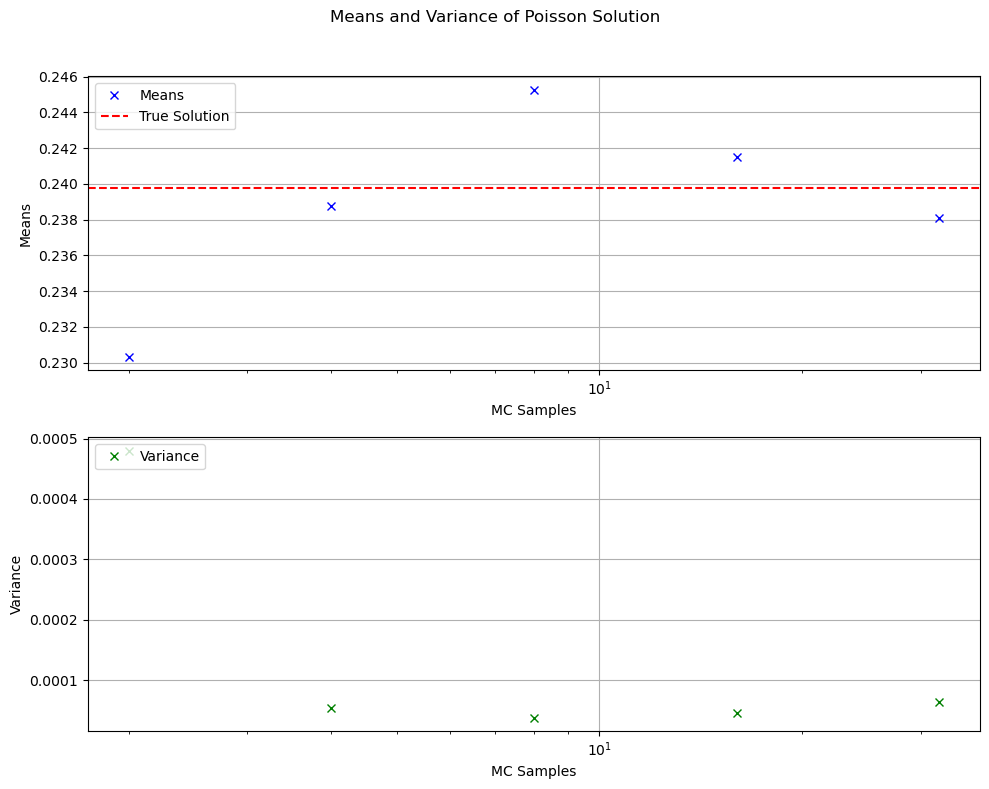

In [11]:
mc_samples_array = [2, 4, 8, 16, 32] # 2:30 per sample with mesh_resolution_solution = 4

P = fe.Point(0.01, 0.01)
mesh_resolution_inverse_mapping = 8
mesh_resolution_solution = 4
mesh_resolution_fem_true_sol = 4

means = []
vars = []

for mc_samples in mc_samples_array:
    u_sols = []
    for i in range(mc_samples):
        print(f"Iteration {i+1}/{mc_samples}")
        xi = np.random.uniform(-np.sqrt(3), np.sqrt(3), randomFieldV.J)
        P_hat = inverse_mapping(P, randomFieldV, xi, mesh_resolution_inverse_mapping)
        u_sols.append(solve_poisson_for_given_sample(mesh_resolution_solution, jacobianV, xi, RHS_F)(P_hat))
    means.append(np.mean(u_sols))
    vars.append(np.var(u_sols, ddof=1))

true_sol_P = true_sol(mesh_resolution_fem_true_sol)(P)

# Plotting
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))

# Plot means and true solution
ax1.plot(mc_samples_array, means, 'bo', marker='x', linestyle='None', label='Means')
ax1.axhline(y=true_sol_P, color='r', linestyle='--', label='True Solution')
ax1.set_xscale('log')
ax1.set_xlabel('MC Samples')
ax1.set_ylabel('Means')
ax1.legend(loc='upper left')
ax1.grid(True)

# Plot variance
ax2.plot(mc_samples_array, vars, 'go', marker='x', linestyle='None', label='Variance')
ax2.set_xscale('log')
ax2.set_xlabel('MC Samples')
ax2.set_ylabel('Variance')
ax2.legend(loc='upper left')
ax2.grid(True)

plt.suptitle('Means and Variance of Poisson Solution')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

R_nv (maximal perturbation distance): 0.6763914647263898
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
*** Warning: Degree of exact solution may be inadequate for accurate result in errornorm.
*** Warning: Degree of exact solution may be inadequate for accurate result in errornorm.
R_nv (maximal perturbation distance): 0.6763914647263898
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
*** Warning: Degree of exact solution may be inadequate for accurate result in errornorm.
*** Warning: Degree of exact solution may be inadequate for accurate result in errornorm.
R_nv (maximal perturbation distance): 0.6763914647263898
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
Solving linear variational problem.
S

/var/folders/0n/bb4_kwsn3n5c5_7n_mgl2n540000gn/T/ipykernel_56287/1430119115.py:49: UserWarning:

marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.

/var/folders/0n/bb4_kwsn3n5c5_7n_mgl2n540000gn/T/ipykernel_56287/1430119115.py:57: UserWarning:

marker is redundantly defined by the 'marker' keyword argument and the fmt string "go" (-> marker='o'). The keyword argument will take precedence.



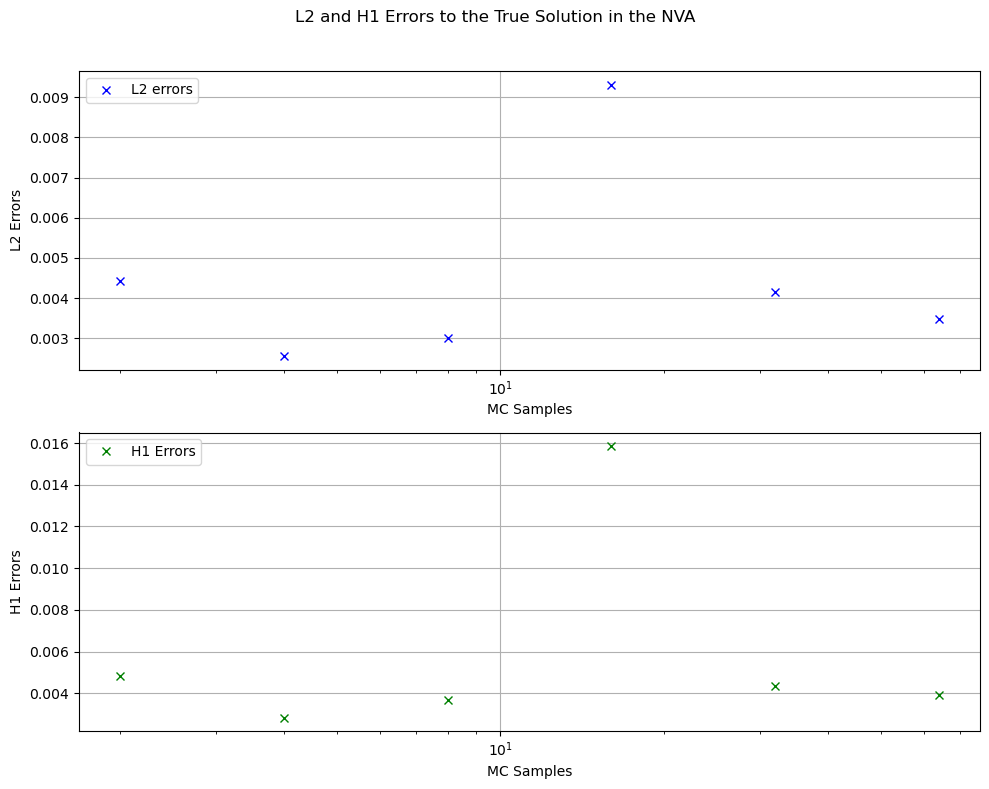

In [12]:
mc_sample_sizes = [2, 4, 8, 16, 32, 64]
len_xi = 8
mesh_resolution_NVA = 6
mesh_resolution_inverse_mapping = 4
mesh_resolution_solution = 4
mesh_resolution_true_sol = 6

L2_errors = []
H1_errors = []

for mc_sample_size in mc_sample_sizes:
    # Maybe consider pushing out some fixed code of the loop, but for refactoring reasons it is kept here

    xis = [np.random.uniform(-np.sqrt(3), np.sqrt(3), len_xi) for _ in range(mc_sample_size)]

    NVA = non_varying_area(len_xi, randomFieldV)
    mesh_NVA = mshr.generate_mesh(NVA, mesh_resolution_NVA)

    V = fe.FunctionSpace(mesh_NVA, 'P', 1)
    dofmap = V.dofmap()
    dof_coordinates = V.tabulate_dof_coordinates().reshape((-1, mesh_NVA.geometry().dim())) # Those are all the point in mesh_NVA but ordered by the dof which we need to assign by the means

    u_P_NVA_mean = np.zeros(len(dof_coordinates))

    u_sols = []
    for xi in xis:
        u_sols.append(solve_poisson_for_given_sample(mesh_resolution_solution, jacobianV, xi, RHS_F))
        
    for i, P_coords in enumerate(dof_coordinates):
        P = fe.Point(P_coords) #! loop can be optimized
        for xi, u_sol in zip(xis, u_sols):
            P_hat = inverse_mapping(P, randomFieldV, xi, mesh_resolution_inverse_mapping)
            u_P_NVA_mean[i] += u_sol(P_hat) / mc_sample_size

    u_mean = fe.Function(V)
    u_mean.vector()[:] = u_P_NVA_mean

    u_true = true_sol(mesh_resolution_true_sol)
    u_true_interpolated = fe.interpolate(u_true, V)

    L2_errors.append(fe.errornorm(u_true_interpolated, u_mean, norm_type='L2'))
    H1_errors.append(fe.errornorm(u_true_interpolated, u_mean, norm_type='H1'))


# Plotting
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))

# Plot means and true solution
ax1.plot(mc_sample_sizes, L2_errors, 'bo', marker='x', linestyle='None', label='L2 errors')
ax1.set_xscale('log')
ax1.set_xlabel('MC Samples')
ax1.set_ylabel('L2 Errors')
ax1.legend(loc='upper left')
ax1.grid(True)

# Plot variance
ax2.plot(mc_sample_sizes, H1_errors, 'go', marker='x', linestyle='None', label='H1 Errors')
ax2.set_xscale('log')
ax2.set_xlabel('MC Samples')
ax2.set_ylabel('H1 Errors')
ax2.legend(loc='upper left')
ax2.grid(True)

plt.suptitle('L2 and H1 Errors to the True Solution in the NVA')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()